In [79]:
import xarray as xr
import numpy as np
import pandas as pd
import glob
import datetime
import matplotlib.pyplot as plt
import pickle

In [103]:
with open('era5df.pdkl','rb') as file:
    
# note: buoyancy here was calculated by interpolating along ARM altitude increments of 20 meters
    
    era5buoyancy = pickle.load(file)

In [52]:
# reading in fig 5&6 df

with open('soundings_fig5&6.pdkl','rb') as file:
    
    soundings = pickle.load(file)
    
soundings['date'] = soundings.index.date
    
# # Assuming your DataFrame is named 'df'
soundings = soundings.reset_index(drop=True)

datetime.date(2001, 8, 2)

In [2]:
cf_lat = 36.60

cf_lon = -97.48

base_path = '/home/annierosen16/data/era5sgp/era5_sl_hourly_precip_cf'

file_pattern = f"{base_path}/20*"

file_list = glob.glob(file_pattern)

p_era = xr.open_mfdataset(file_list, combine='by_coords', chunks={'time': 24})

nearest_gridpoint = p_era.sel(latitude=cf_lat, longitude=cf_lon, method='nearest')

p_era_cf = p_era.sel(latitude=nearest_gridpoint['latitude'].values, longitude=nearest_gridpoint['longitude'].values)

ERAdf = p_era_cf.assign_coords(valid_time=p_era_cf.valid_time - pd.Timedelta(hours=6))

In [18]:
# # gloria APE cases

# ape_cases = xr.open_dataset("APEs_time_data.nc")

# ape_cases_date = pd.to_datetime(ape_cases['time'], unit='D', origin='1970-01-01')

# ape_cases_type = ape_cases['LAC_idx']

# ape_cases_df = pd.DataFrame({
    
#     'date': ape_cases_date,
    
#     'type': ape_cases_type
# })

# ape_cases_df = ape_cases_df.set_index("date")

# ape_cases_df['type'] = ape_cases_df['type'].replace({0: 'dry_coupling', 1: 'wet_coupling', 2: 'neither'})

# ape_cases_df['dry_coupling'] = ape_cases_df['type'] == 'dry_coupling'

# ape_cases_df['wet_coupling'] = ape_cases_df['type'] == 'wet_coupling'

# ape_cases_df['APE'] = True

# gloria_apes = ape_cases_df.drop('type', axis=1)

In [19]:
# gloria_apes.reset_index(inplace=True)

# # Rename the new column that was created (optional)
# gloria_apes.rename(columns={'index': 'date'}, inplace=True)

# # Extract only the date part of the timestamp
# gloria_apes['date'] = pd.to_datetime(gloria_apes['date']).dt.date

In [5]:
# total precipitation accumulation in mm 

ERAtp = ERAdf['tp'].load().data * 1000

ERAtimes = ERAdf['valid_time'].data

In [8]:
def is_ape(precip, times):
    
    # put arrays into a df 
    
    df = pd.DataFrame({'precip': precip, 'time': times})
    
    df['date'] = df['time'].dt.date
    
    df['hour'] = df['time'].dt.hour
    
    # adjusting times so that the 0th hour is labeled as the 24th of the previous day
    # purpose is to calculate evening precipitation more easily 
    
    df.loc[df['hour'] == 0, 'hour'] = 24
    
    df.loc[df['hour'] == 24, 'date'] = df['date'] - pd.Timedelta(days=1)

    results = []
    
    for date, group in df.groupby('date'):
        
        num_hours = len(group['hour'].values)
        
        if num_hours == 24:
        
            group = group.reset_index(drop=True)

            morning_precip = group[(group['hour'] >= 6) & (group['hour'] <= 13)]['precip'].sum()

            afternoon_precip = group[(group['hour'] >= 14) & (group['hour'] <= 20)]['precip'].sum()

            evening_precip = group[(group['hour'] >= 21) & (group['hour'] <= 24)]['precip'].sum()

            condition_1 = afternoon_precip >= 2 * morning_precip

            condition_2 = afternoon_precip > evening_precip

            peak_hour = group.iloc[group['precip'].idxmax()]['hour']

            peak_in_afternoon = 14 <= peak_hour <= 20 

            condition_3 = peak_in_afternoon 

            daily_precip = group['precip'].values 

            if condition_1 and condition_2 and condition_3:

                print(date, "APE found")

                results.append((date, True, daily_precip, np.nan))

            else:

                print(date, "no APE")

                failed_conditions = []

                if not condition_1:

                    failed_conditions.append("morning precipitation < 2x afternoon precipitation")

                if not condition_2: 

                    failed_conditions.append("afternoon precipitation < evening precipitation: ")

                if not condition_3: 

                    failed_conditions.append("Peak precipitation hour not in afternoon")

                results.append((date, False, daily_precip, failed_conditions))
                
        else: 
            
            print(date, "not enough hours to determine")
            
            results.append((date, False, np.nan, "Not enough hours in the day to determine"))

    return results

ape_test = is_ape(ERAtp, ERAtimes)

annie_apes = pd.DataFrame(ape_test, columns=['date', 'APE', 'daily_precip', 'reason_for_fail'])

2001-04-30 not enough hours to determine
2001-05-01 APE found
2001-05-02 no APE
2001-05-03 no APE
2001-05-04 no APE
2001-05-05 no APE
2001-05-06 no APE
2001-05-07 APE found
2001-05-08 no APE
2001-05-09 no APE
2001-05-10 no APE
2001-05-11 APE found
2001-05-12 no APE
2001-05-13 no APE
2001-05-14 no APE
2001-05-15 no APE
2001-05-16 no APE
2001-05-17 APE found
2001-05-18 no APE
2001-05-19 no APE
2001-05-20 no APE
2001-05-21 no APE
2001-05-22 no APE
2001-05-23 no APE
2001-05-24 no APE
2001-05-25 no APE
2001-05-26 APE found
2001-05-27 no APE
2001-05-28 no APE
2001-05-29 no APE
2001-05-30 no APE
2001-05-31 no APE
2001-06-01 no APE
2001-06-02 no APE
2001-06-03 no APE
2001-06-04 no APE
2001-06-05 no APE
2001-06-06 no APE
2001-06-07 no APE
2001-06-08 APE found
2001-06-09 no APE
2001-06-10 no APE
2001-06-11 no APE
2001-06-12 no APE
2001-06-13 no APE
2001-06-14 no APE
2001-06-15 no APE
2001-06-16 no APE
2001-06-17 no APE
2001-06-18 no APE
2001-06-19 no APE
2001-06-20 no APE
2001-06-21 no APE
2001-

2004-05-10 APE found
2004-05-11 no APE
2004-05-12 no APE
2004-05-13 no APE
2004-05-14 no APE
2004-05-15 no APE
2004-05-16 no APE
2004-05-17 no APE
2004-05-18 no APE
2004-05-19 no APE
2004-05-20 no APE
2004-05-21 no APE
2004-05-22 no APE
2004-05-23 no APE
2004-05-24 APE found
2004-05-25 no APE
2004-05-26 APE found
2004-05-27 no APE
2004-05-28 no APE
2004-05-29 no APE
2004-05-30 no APE
2004-05-31 no APE
2004-06-01 APE found
2004-06-02 no APE
2004-06-03 no APE
2004-06-04 no APE
2004-06-05 no APE
2004-06-06 no APE
2004-06-07 no APE
2004-06-08 no APE
2004-06-09 no APE
2004-06-10 no APE
2004-06-11 no APE
2004-06-12 APE found
2004-06-13 no APE
2004-06-14 no APE
2004-06-15 no APE
2004-06-16 APE found
2004-06-17 no APE
2004-06-18 no APE
2004-06-19 no APE
2004-06-20 no APE
2004-06-21 no APE
2004-06-22 no APE
2004-06-23 no APE
2004-06-24 no APE
2004-06-25 no APE
2004-06-26 APE found
2004-06-27 no APE
2004-06-28 no APE
2004-06-29 APE found
2004-06-30 no APE
2004-07-01 no APE
2004-07-02 no APE
2004

2007-06-19 no APE
2007-06-20 no APE
2007-06-21 no APE
2007-06-22 APE found
2007-06-23 no APE
2007-06-24 APE found
2007-06-25 no APE
2007-06-26 no APE
2007-06-27 no APE
2007-06-28 no APE
2007-06-29 APE found
2007-06-30 no APE
2007-07-01 APE found
2007-07-02 no APE
2007-07-03 no APE
2007-07-04 no APE
2007-07-05 APE found
2007-07-06 no APE
2007-07-07 no APE
2007-07-08 no APE
2007-07-09 no APE
2007-07-10 no APE
2007-07-11 no APE
2007-07-12 no APE
2007-07-13 no APE
2007-07-14 no APE
2007-07-15 no APE
2007-07-16 APE found
2007-07-17 no APE
2007-07-18 no APE
2007-07-19 no APE
2007-07-20 no APE
2007-07-21 no APE
2007-07-22 APE found
2007-07-23 no APE
2007-07-24 no APE
2007-07-25 no APE
2007-07-26 no APE
2007-07-27 APE found
2007-07-28 no APE
2007-07-29 no APE
2007-07-30 no APE
2007-07-31 APE found
2007-08-01 no APE
2007-08-02 no APE
2007-08-03 no APE
2007-08-04 no APE
2007-08-05 no APE
2007-08-06 no APE
2007-08-07 APE found
2007-08-08 APE found
2007-08-09 no APE
2007-08-10 no APE
2007-08-11 no

2010-07-25 APE found
2010-07-26 APE found
2010-07-27 APE found
2010-07-28 APE found
2010-07-29 APE found
2010-07-30 no APE
2010-07-31 APE found
2010-08-01 APE found
2010-08-02 no APE
2010-08-03 no APE
2010-08-04 no APE
2010-08-05 no APE
2010-08-06 no APE
2010-08-07 APE found
2010-08-08 APE found
2010-08-09 APE found
2010-08-10 APE found
2010-08-11 no APE
2010-08-12 no APE
2010-08-13 no APE
2010-08-14 APE found
2010-08-15 APE found
2010-08-16 no APE
2010-08-17 no APE
2010-08-18 no APE
2010-08-19 no APE
2010-08-20 no APE
2010-08-21 no APE
2010-08-22 no APE
2010-08-23 APE found
2010-08-24 no APE
2010-08-25 no APE
2010-08-26 no APE
2010-08-27 no APE
2010-08-28 no APE
2010-08-29 APE found
2010-08-30 no APE
2010-08-31 APE found
2010-09-01 APE found
2010-09-02 APE found
2010-09-03 no APE
2010-09-04 no APE
2010-09-05 no APE
2010-09-06 no APE
2010-09-07 no APE
2010-09-08 no APE
2010-09-09 no APE
2010-09-10 no APE
2010-09-11 no APE
2010-09-12 APE found
2010-09-13 APE found
2010-09-14 no APE
2010

2013-08-31 no APE
2013-09-01 no APE
2013-09-02 no APE
2013-09-03 no APE
2013-09-04 no APE
2013-09-05 no APE
2013-09-06 APE found
2013-09-07 no APE
2013-09-08 no APE
2013-09-09 no APE
2013-09-10 APE found
2013-09-11 no APE
2013-09-12 APE found
2013-09-13 no APE
2013-09-14 no APE
2013-09-15 no APE
2013-09-16 APE found
2013-09-17 no APE
2013-09-18 APE found
2013-09-19 no APE
2013-09-20 no APE
2013-09-21 no APE
2013-09-22 no APE
2013-09-23 no APE
2013-09-24 no APE
2013-09-25 no APE
2013-09-26 no APE
2013-09-27 no APE
2013-09-28 no APE
2013-09-29 no APE
2013-09-30 not enough hours to determine
2014-04-30 not enough hours to determine
2014-05-01 no APE
2014-05-02 no APE
2014-05-03 no APE
2014-05-04 no APE
2014-05-05 no APE
2014-05-06 APE found
2014-05-07 no APE
2014-05-08 no APE
2014-05-09 no APE
2014-05-10 APE found
2014-05-11 no APE
2014-05-12 no APE
2014-05-13 no APE
2014-05-14 no APE
2014-05-15 no APE
2014-05-16 APE found
2014-05-17 no APE
2014-05-18 no APE
2014-05-19 no APE
2014-05-20 n

2017-05-26 no APE
2017-05-27 no APE
2017-05-28 no APE
2017-05-29 APE found
2017-05-30 no APE
2017-05-31 no APE
2017-06-01 no APE
2017-06-02 no APE
2017-06-03 APE found
2017-06-04 no APE
2017-06-05 no APE
2017-06-06 no APE
2017-06-07 no APE
2017-06-08 APE found
2017-06-09 no APE
2017-06-10 no APE
2017-06-11 no APE
2017-06-12 no APE
2017-06-13 no APE
2017-06-14 no APE
2017-06-15 no APE
2017-06-16 no APE
2017-06-17 no APE
2017-06-18 no APE
2017-06-19 no APE
2017-06-20 no APE
2017-06-21 no APE
2017-06-22 no APE
2017-06-23 APE found
2017-06-24 no APE
2017-06-25 no APE
2017-06-26 no APE
2017-06-27 no APE
2017-06-28 no APE
2017-06-29 no APE
2017-06-30 no APE
2017-07-01 no APE
2017-07-02 no APE
2017-07-03 APE found
2017-07-04 no APE
2017-07-05 no APE
2017-07-06 no APE
2017-07-07 APE found
2017-07-08 no APE
2017-07-09 APE found
2017-07-10 no APE
2017-07-11 no APE
2017-07-12 no APE
2017-07-13 no APE
2017-07-14 APE found
2017-07-15 APE found
2017-07-16 no APE
2017-07-17 no APE
2017-07-18 no APE
2

In [155]:
np.sum(annie_apes['APE'])

564

In [140]:
# Filter both DataFrames where APE is True

df1_ape_true = annie_apes[annie_apes['APE'] == True].reset_index(drop=True)

print("% of days with APEs from ERA5:", (df1_ape_true.shape[0]/annie_apes.shape[0])*100)

df2_ape_true = soundings[soundings['APE'] == True].reset_index(drop=True)

print("% of days with APEs from ARM Radiosondes:", (df2_ape_true.shape[0]/soundings.shape[0])*100)

common_ape_dates = pd.merge(df1_ape_true[['date', 'daily_precip']], df2_ape_true[['date', 'all_hours']], on='date')

# Convert to a list
shared_apes_list = common_ape_dates['date'].tolist()

% of days with APEs from ERA5: 20.346320346320347
% of days with APEs from ARM Radiosondes: 14.513193812556871


In [ ]:
# dumping to read in to buoyancy comparison

with open('shared_apes_list.pkl', 'wb') as f:
    
    pickle.dump(shared_apes_list, f)

In [143]:
# Filter both DataFrames where APE is False

df1_ape_false = annie_apes[annie_apes['APE'] == False].reset_index(drop=True)

print("% of days with APEs from ERA5:", (df1_ape_false.shape[0]/annie_apes.shape[0])*100)

df2_ape_false = soundings[soundings['APE'] == False].reset_index(drop=True)

print("% of days with APEs from ARM Radiosondes:", (df2_ape_false.shape[0]/soundings.shape[0])*100)

common_nonape_dates = pd.merge(df1_ape_false[['date', 'daily_precip']], df2_ape_false[['date', 'all_hours']], on='date')

# Convert to a list
shared_nonapes_list = common_nonape_dates['date'].tolist()

% of days with APEs from ERA5: 79.65367965367966
% of days with APEs from ARM Radiosondes: 85.48680618744314


In [145]:
# dumping to read in to buoyancy comparison

with open('shared_nonapes_list.pkl', 'wb') as f:
    
    pickle.dump(shared_nonapes_list, f)

In [74]:
# examining diurnal cycle comparison between ERA5 & ARM

common_dates = common_dates.rename(columns={
    'daily_precip': 'era5_diurnal_cycle',
    'all_hours': 'arm_diurnal_cycle'
})

common_dates['arm_diurnal_cycle'] = common_dates['arm_diurnal_cycle'].apply(np.array)

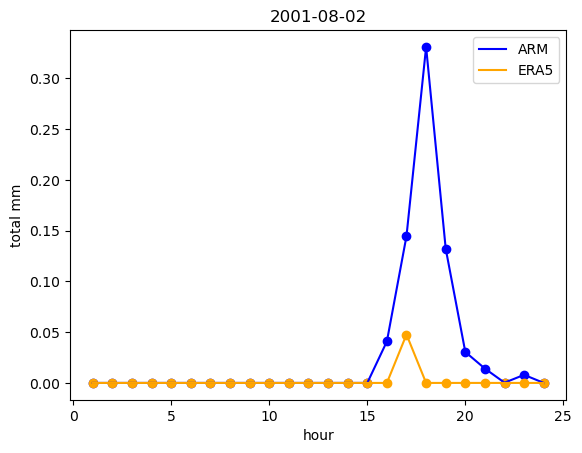

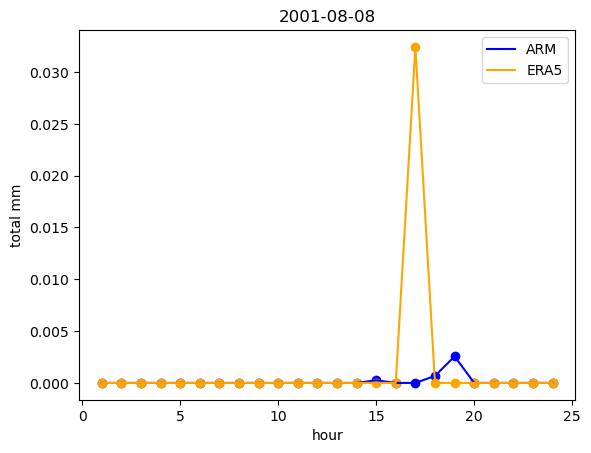

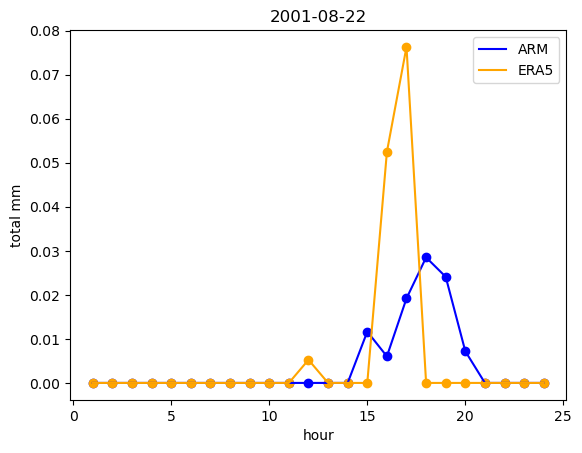

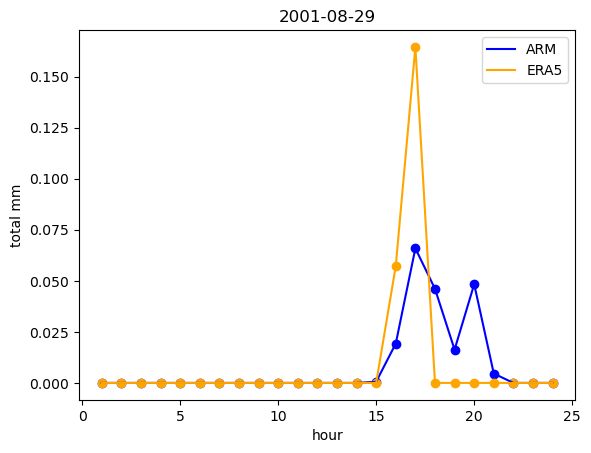

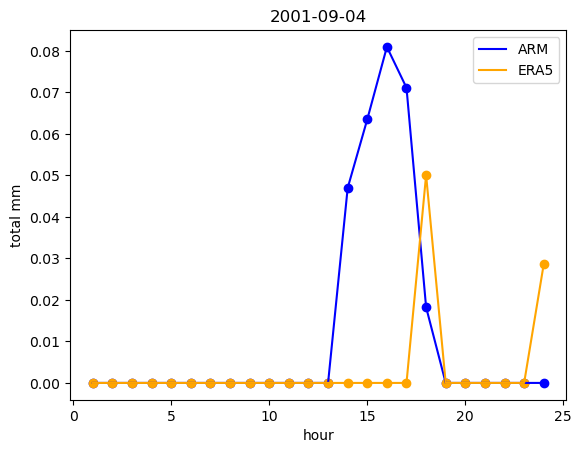

...

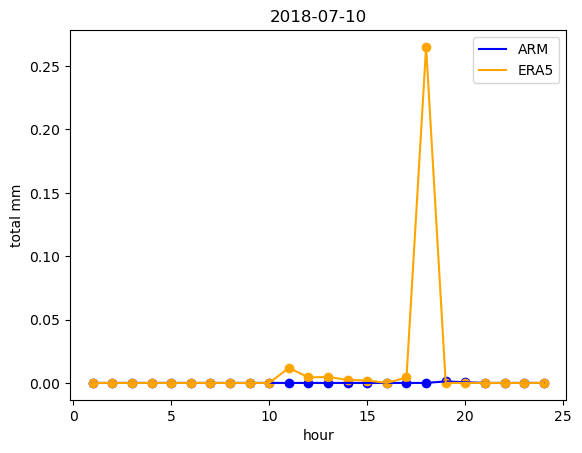

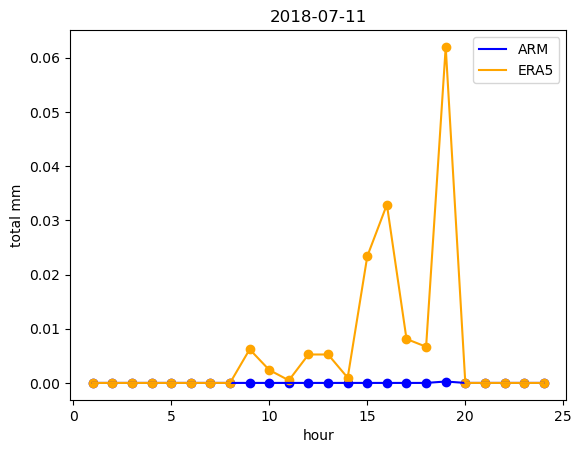

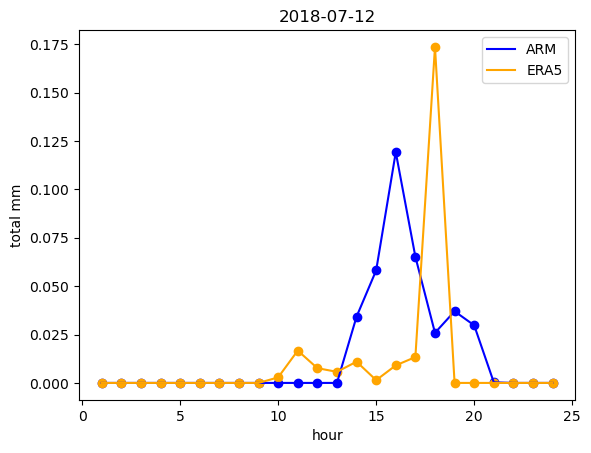

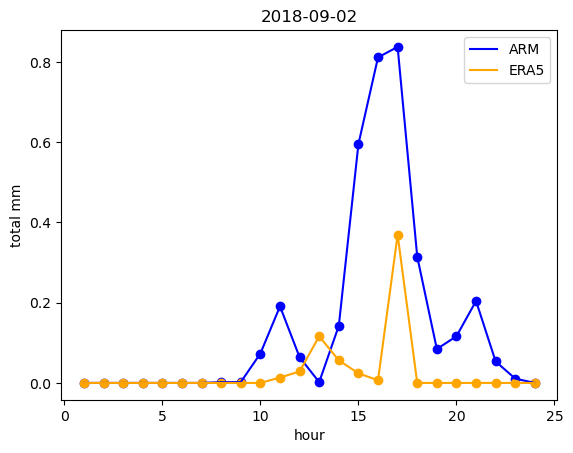

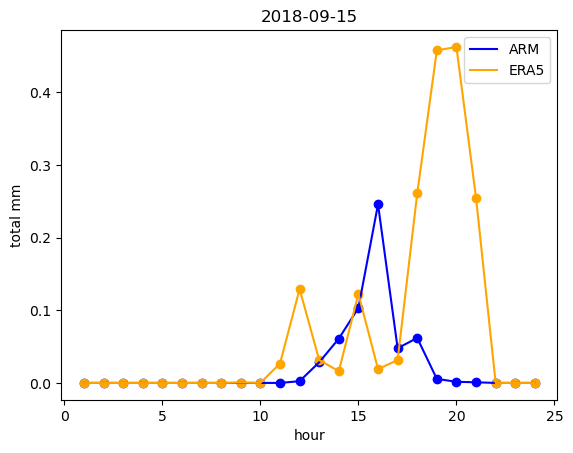

In [93]:
for index in range(common_dates.shape[0]):

    hours = range(1,25)
    
    date = common_dates['date'].iloc[index]

    arm_di = common_dates['arm_diurnal_cycle'].iloc[index]

    era5_di = common_dates['era5_diurnal_cycle'].iloc[index]

    plt.plot(hours, arm_di, label='ARM', color='blue')

    plt.scatter(hours, arm_di, color='blue')

    plt.plot(hours, era5_di, label='ERA5', color='orange')

    plt.scatter(hours, era5_di, color='orange')

    plt.legend()

    plt.ylabel("total mm")

    plt.xlabel("hour")
    
    plt.title("{}".format(date))

    plt.show()


In [55]:
# dumping to read in to buoyancy comparison

with open('shared_apes_list.pkl', 'wb') as f:
    
    pickle.dump(shared_apes_list, f)

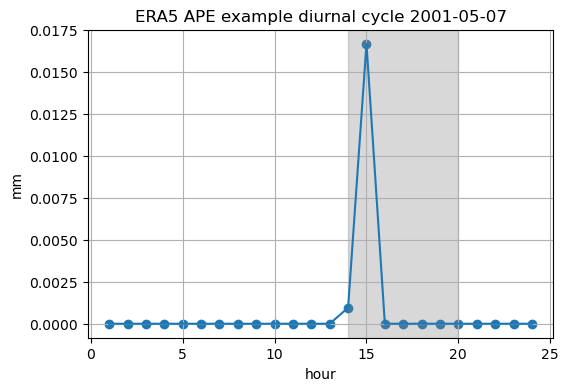

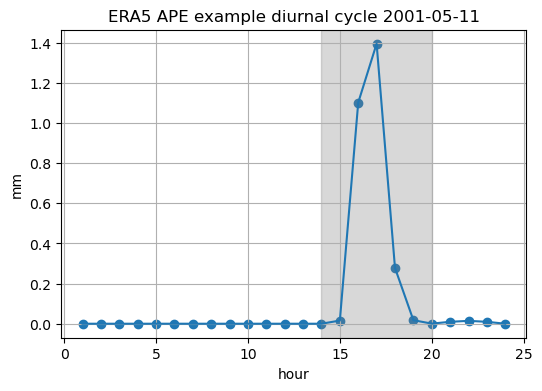

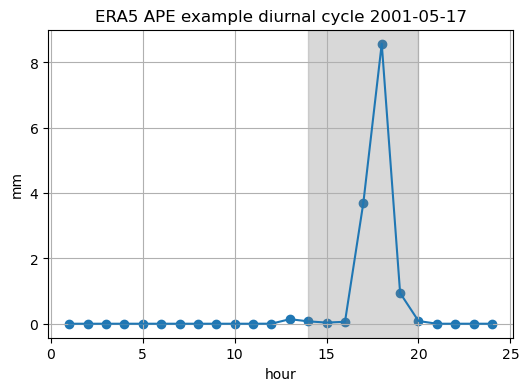

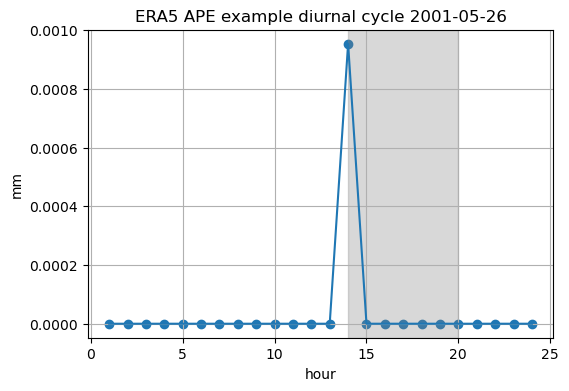

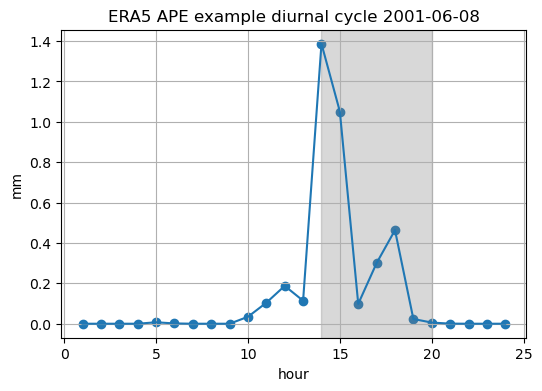

...

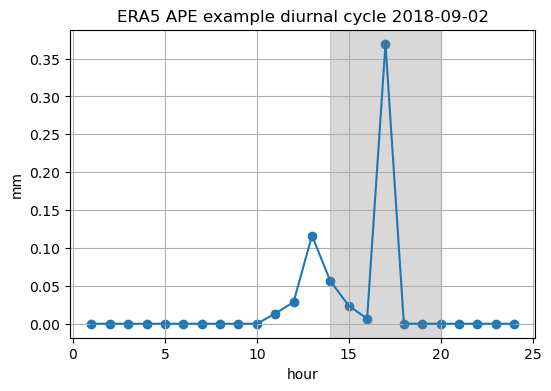

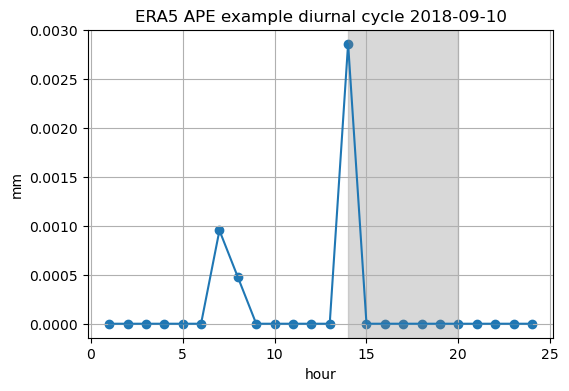

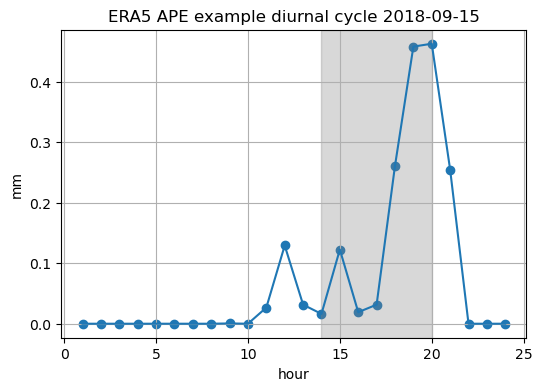

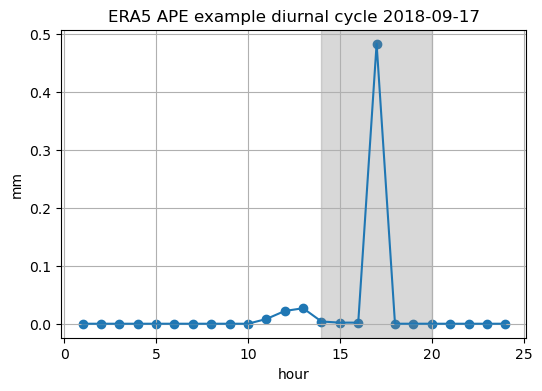

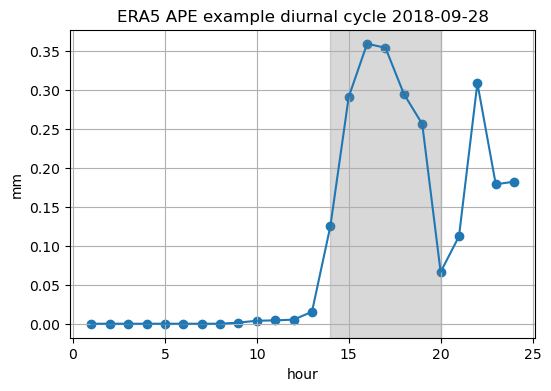

In [431]:
# all ERA5 identified APEs near the CF site

bugs = []

for i in range(1, df1_ape_true.shape[0]):

    times = range(1, 25)

    ape_diurnal_cycle = df1_ape_true['daily_precip'][i]

    date = df1_ape_true['date'][i]
        
#     if date == datetime.date(2002, 5, 28):
        
    plt.figure(figsize=(6, 4))

    bugs.append(ape_diurnal_cycle)

    plt.plot(times, ape_diurnal_cycle)

    plt.scatter(times, ape_diurnal_cycle)

    plt.title("ERA5 APE example diurnal cycle {}".format(date))
    
    plt.axvspan(14, 20, color='gray', alpha=0.3)  # Adjust alpha for transparency

    plt.ylabel("mm")

    plt.xlabel("hour")

    plt.grid()

    plt.show()

In [130]:
era5precip = annie_apes.set_index('date')

era5precip.rename_axis('time', inplace=True)

era5_precip_with_buoyancy = era5buoyancy.join(era5precip, how='inner')

era5_precip_with_buoyancy.shape

In [134]:
# combined ape/non-ape information with buoyancy 

with open('era5_precip_with_buoyancy.pdkl', 'wb') as f:
    
    pickle.dump(era5_precip_with_buoyancy, f)